In [19]:
import os
import sys
import json
from PIL import Image, ImageDraw,ImageFont
import glob
from google.cloud import vision


In [2]:
nb_dir = '/'.join(os.getcwd().split('/')[:-1])
sys.path.append(nb_dir)
sys.path.append(os.path.split(nb_dir)[0])

import config
import src.utilities.app_context as app_context
app_context.init()

#path to craft model, weight can be pulled form the production bracnh of repo
#config.CRAFT_MODEL_PATH= nb_dir + '/utilities/craft_pytorch/model/craft_mlt_25k.pth'
#config.CRAFT_REFINE_MODEL_PATH = nb_dir + '/utilities/craft_pytorch/model/craft_refiner_CTW1500.pth'

In [3]:
from src.services.main import GoogleVisionOCR

[2020-12-01 12:19:32,346] {_default.py:181} MainThread DEBUG in _default: Checking /home/naresh/Tesseract/google_vision/anuvaad-f7a059c268e4.json for explicit credentials as part of auth process...


In [12]:
#base_dir = '/home/dhiraj/Documents/Anuwad/anuvaad/anuvaad-etl/anuvaad-extractor/block-merger/src/notebooks/sample-data/input'
base_dir   = os.getcwd()+'/upload/'
#base_dir  = "/home/naresh/Tarento/anuvaad/anuvaad-etl/anuvaad-extractor/document-processor/ocr/google/upload/"
filename    = 'yolo.pdf'

#filename    = 'hamlet_1.pdf'
file_format = 'PDF'
language    =  'en'

In [13]:
base_dir

'/home/naresh/Tarento/anuvaad/anuvaad-etl/anuvaad-extractor/document-processor/ocr/google/src/notebooks/upload/'

In [14]:
app_context.application_context = {
  "inputs": [
    {
      "file": {
        "identifier": "string",
        "name": filename,
        "format": file_format
      },
      "config": {
        "OCR": {
          "option": "HIGH_ACCURACY",
          "language": language
        }
      }
}
  ]
}

In [15]:
resp = GoogleVisionOCR(app_context)

[2020-12-01 12:37:32,263] {loghandler.py:48} MainThread DEBUG in loghandler: google vision ocr process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'yolo.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}]}
[2020-12-01 12:37:32,268] {loghandler.py:20} MainThread INFO in loghandler: image extraction started ===>
[2020-12-01 12:37:32,276] {loghandler.py:20} MainThread INFO in loghandler: created processing directories successfully upload/yolo_6d3c89b6-da20-4955-a167-997d7cb76724
[2020-12-01 12:37:32,282] {loghandler.py:20} MainThread INFO in loghandler: filepath upload/yolo.pdf, working_dir upload/yolo_6d3c89b6-da20-4955-a167-997d7cb76724
[2020-12-01 12:37:32,569] {loghandler.py:20} MainThread INFO in loghandler: Extraction of images from upload/yolo.pdf completed in 0.2875351905822754
[2020-12-01 12:37:33,062] {requests.py:181} Thread-4 DEBUG in requests: Making request: POST https://oauth2.googleapis.com/token
[2020-12-01 12:37:3

In [8]:
file_index = 0
page_index =0
#filepath = '/home/naresh/Tarento/anuvaad2/anuvaad-etl/anuvaad-extractor/block-merger/src/notebooks/sample-data/class1/test_children_023985fa-28d9-11eb-8434-38baf82f7425/images/test_children0001-1.jpg'

save_dir = '/home/naresh/Tarento/anuvaad2/anuvaad-etl/anuvaad-extractor/block-merger/src/notebooks/sample-data/class1/test_layout_detector/'
#resp['rsp']['outputs'][file_index]['pages'][page_index]['words'][0]

def draw_box(thresh,resp,filepath,save_dir,json_name,color="green", save=False):
    image  = Image.open(filepath)
    draw   = ImageDraw.Draw(image)
    for i in resp['rsp']['outputs'][0]['pages'][0]['regions']:
        #font = ImageFont.truetype("sans-serif.ttf", 30)
        #draw.text((10, 10),thresh,(255,0,255))
        #print("kkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkk",i)
        draw.rectangle(((i['boundingBox']['vertices'][0]['x'], i['boundingBox']['vertices'][0]['y']), (i['boundingBox']['vertices'][2]['x'],i['boundingBox']['vertices'][2]['y'])), outline=color,width=3)
        
    
    save_filepath = os.path.join(save_dir, "bbox_layout_"+str(json_name)+"_"+str(thresh)+"_"+os.path.basename(filepath))
    if save:
        image.save(save_filepath)
    
    return image

In [9]:
#image = draw_box(resp,resp['rsp']['outputs'][0]['page_info'][0],save_dir ,color="green", save=True) 
json_path_dir = "/home/naresh/word_detector/"
validate_layout(json_path_dir)

[2020-11-18 22:02:53,075] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'ccf53be2168e4cab9471a2b246748660', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '8a681c89ca65450da6f65b1ff2a9dee2', 'class': 'TEXT', 'font': {'family': 'Arial Unicode MS', 'size': 83, 'style': 'REGULAR'}}, {'boundingBox': {'vertices': [{'x': 1639, 'y': 546}, {'x': 1660, 'y': 546}, {'x': 1660, 'y': 577}, {'x': 1639, 'y': 57

[2020-11-18 22:02:57,746] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.0_0.0_
[2020-11-18 22:02:57,999] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'ccf53be2168e4cab9471a2b246748660', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '987d7d14-ddd0-4192-b1e3-be58768621a9', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': '09d

[2020-11-18 22:03:02,066] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.0_0.0_
[2020-11-18 22:03:02,305] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'ccf53be2168e4cab9471a2b246748660', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'ee44fa64-5027-4d71-a505-9365d659735e', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': '338

[2020-11-18 22:03:06,254] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.0_0.0_
[2020-11-18 22:03:06,491] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'ccf53be2168e4cab9471a2b246748660', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '6bbd6289-c74a-4333-b3cf-a0c5ef1501e0', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': 'cd0

[2020-11-18 22:03:10,821] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.0_0.0_
[2020-11-18 22:03:11,072] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '113e497c30b4457e91650912d49fc147', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': 'd769c3f566c64b63b97ad59ca7892e30', 'class': 'TEXT', 'font':

[2020-11-18 22:03:15,518] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.4_0.4_
[2020-11-18 22:03:15,801] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '113e497c30b4457e91650912d49fc147', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'd712ace3-c235-4248-8f84-ce26e660846c', 'boundingBox': {'vertices': [{'x': 2119, 'y': 2108}, {'x': 2217, 'y': 2108}, {'x': 2217, 'y': 2150}, {'x': 2119, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:03:20,887] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.4_0.4_
[2020-11-18 22:03:21,139] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '113e497c30b4457e91650912d49fc147', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'c7219668-b649-442d-ac1a-017f4c2fd595', 'boundingBox': {'vertices': [{'x': 2119, 'y': 2108}, {'x': 2217, 'y': 2108}, {'x': 2217, 'y': 2150}, {'x': 2119, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:03:25,163] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.4_0.4_
[2020-11-18 22:03:25,400] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '113e497c30b4457e91650912d49fc147', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'ec8fe4c7-63a4-43fd-905e-25660ee288da', 'boundingBox': {'vertices': [{'x': 2119, 'y': 2108}, {'x': 2217, 'y': 2108}, {'x': 2217, 'y': 2150}, {'x': 2119, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:03:29,390] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.4_0.4_
[2020-11-18 22:03:29,637] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'e69776df72804118b0c2dd5221ed7806', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': 'c327f4bbc0664dc2bd735f48e0938c97', 'class': 'TEXT', 'font':

[2020-11-18 22:03:34,214] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.4_0.0_
[2020-11-18 22:03:34,450] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'e69776df72804118b0c2dd5221ed7806', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'f37cd699-d27d-4965-92da-0712ab71b30f', 'boundingBox': {'vertices': [{'x': 2119, 'y': 2108}, {'x': 2217, 'y': 2108}, {'x': 2217, 'y': 2150}, {'x': 2119, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:03:38,415] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.4_0.0_
[2020-11-18 22:03:38,650] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'e69776df72804118b0c2dd5221ed7806', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '7dca0826-1663-4523-80b7-956dc7e438b6', 'boundingBox': {'vertices': [{'x': 2119, 'y': 2108}, {'x': 2217, 'y': 2108}, {'x': 2217, 'y': 2150}, {'x': 2119, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:03:42,934] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.4_0.0_
[2020-11-18 22:03:43,175] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'e69776df72804118b0c2dd5221ed7806', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'd8c4fc78-b9d0-4ee9-86e8-b3c9ed38394b', 'boundingBox': {'vertices': [{'x': 2119, 'y': 2108}, {'x': 2217, 'y': 2108}, {'x': 2217, 'y': 2150}, {'x': 2119, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:03:48,002] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.4_0.0_
[2020-11-18 22:03:48,252] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '151dfecf98c64d6590c781b5327d33ac', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '573eeb87e6174f35a85f6247eaec47b6', 'class': 'TEXT', 'font':

[2020-11-18 22:03:52,427] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.0_0.0_
[2020-11-18 22:03:52,664] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '151dfecf98c64d6590c781b5327d33ac', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'b53918e6-3e35-4136-af65-42cb1dd5a4da', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': '393

[2020-11-18 22:03:56,994] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.0_0.0_
[2020-11-18 22:03:57,229] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '151dfecf98c64d6590c781b5327d33ac', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '2c2adb8a-87ce-4552-b713-fc3ee55b0b10', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': '4ad

[2020-11-18 22:04:01,210] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.0_0.0_
[2020-11-18 22:04:01,451] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '151dfecf98c64d6590c781b5327d33ac', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'b787c6e0-b837-474a-8ca8-cb6b22c795f3', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': 'cc8

[2020-11-18 22:04:06,207] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.0_0.0_
[2020-11-18 22:04:06,458] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '5647e331b49d40f0978e88f96615a844', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '9c283571463147d5b76195b1410d47df', 'class': 'TEXT', 'font':

[2020-11-18 22:04:11,054] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.4_0.4_
[2020-11-18 22:04:11,302] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '5647e331b49d40f0978e88f96615a844', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '8975e98e-771c-4239-94eb-94354f9ee7d5', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:04:15,645] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.4_0.4_
[2020-11-18 22:04:15,889] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '5647e331b49d40f0978e88f96615a844', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '35045f52-ff1c-4daa-a066-b2b018bee400', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:04:20,191] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.4_0.4_
[2020-11-18 22:04:20,504] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '5647e331b49d40f0978e88f96615a844', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '0587e7e3-df57-44a8-91a3-1c431c169b40', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:04:25,377] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.4_0.4_
[2020-11-18 22:04:25,770] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'c890714f7b8e486f91ced70bcb54d7de', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': 'efefe5434760453a88db14d7ecc678c1', 'class': 'TEXT', 'font':

[2020-11-18 22:04:29,975] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.2_0.0_
[2020-11-18 22:04:30,236] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'c890714f7b8e486f91ced70bcb54d7de', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '9184ced7-c097-4c95-87d1-3c12617b1cea', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:04:34,894] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.2_0.0_
[2020-11-18 22:04:35,179] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'c890714f7b8e486f91ced70bcb54d7de', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '546c8686-ccbf-44fd-a9a8-c8fea6a6d8f7', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:04:39,598] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.2_0.0_
[2020-11-18 22:04:39,843] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'c890714f7b8e486f91ced70bcb54d7de', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'b1a67bbc-6266-49bf-b046-164cf7facfe8', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:04:44,427] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.2_0.0_
[2020-11-18 22:04:44,671] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '68ccdbecee5a468ba18526291b2ae511', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '30fbb9a9f52842458149843b5cf9772b', 'class': 'TEXT', 'font':

[2020-11-18 22:04:48,891] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.4_0.2_
[2020-11-18 22:04:49,131] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '68ccdbecee5a468ba18526291b2ae511', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'db22cb81-a032-475b-b8bf-b7a832948c20', 'boundingBox': {'vertices': [{'x': 2119, 'y': 2108}, {'x': 2217, 'y': 2108}, {'x': 2217, 'y': 2150}, {'x': 2119, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:04:53,434] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.4_0.2_
[2020-11-18 22:04:53,677] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '68ccdbecee5a468ba18526291b2ae511', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'bbd3e927-7ad4-4951-b15b-d3752e7fb7ec', 'boundingBox': {'vertices': [{'x': 2119, 'y': 2108}, {'x': 2217, 'y': 2108}, {'x': 2217, 'y': 2150}, {'x': 2119, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:04:58,467] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.4_0.2_
[2020-11-18 22:04:58,711] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '68ccdbecee5a468ba18526291b2ae511', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'ed292b3c-1011-44f0-b893-d845765b6870', 'boundingBox': {'vertices': [{'x': 2119, 'y': 2108}, {'x': 2217, 'y': 2108}, {'x': 2217, 'y': 2150}, {'x': 2119, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:05:02,822] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.4_0.2_
[2020-11-18 22:05:03,067] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '6ad0dd97100942cfb04073bc9e2f9201', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '8fdc66143ffe4085be151938eaee4c43', 'class': 'TEXT', 'font':

[2020-11-18 22:05:07,625] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.2_0.2_
[2020-11-18 22:05:07,883] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '6ad0dd97100942cfb04073bc9e2f9201', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'b28f2cac-4781-435e-8e3b-f2fba50f19f2', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': '

[2020-11-18 22:05:12,002] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.2_0.2_
[2020-11-18 22:05:12,268] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '6ad0dd97100942cfb04073bc9e2f9201', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'b907883a-5445-4b7b-abb1-c5f668aad303', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': '

[2020-11-18 22:05:16,369] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.2_0.2_
[2020-11-18 22:05:16,607] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '6ad0dd97100942cfb04073bc9e2f9201', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'a23f7874-ca0a-479c-b4b0-31ab1c3ab319', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': '

[2020-11-18 22:05:20,624] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.2_0.2_
[2020-11-18 22:05:20,931] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'e84777254bef4b128549d7327dc6c7df', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': 'bd50d5749ded4c7a9b90863f53ee700e', 'class': 

[2020-11-18 22:05:25,404] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.4_0.0_
[2020-11-18 22:05:25,776] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'e84777254bef4b128549d7327dc6c7df', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '9804627b-3a35-4f02-802a-a9389b4fe00e', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:05:30,049] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.4_0.0_
[2020-11-18 22:05:30,300] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'e84777254bef4b128549d7327dc6c7df', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'e372c660-17fa-40af-a410-b27536f31e00', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:05:34,512] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.4_0.0_
[2020-11-18 22:05:34,753] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'e84777254bef4b128549d7327dc6c7df', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '95cda33b-e603-47fa-9e76-8d57d5346229', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:05:39,913] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.4_0.0_
[2020-11-18 22:05:40,167] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'cc03c3dc0144496e9da293acb14584d2', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': 'f0eb5ae47a0e46d687e4e85cafd7a176', 'class': 'TEXT', 'font':

[2020-11-18 22:05:44,878] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.2_0.2_
[2020-11-18 22:05:45,139] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'cc03c3dc0144496e9da293acb14584d2', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '42db5807-ec44-45e5-9ace-795172a19bd1', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:05:49,262] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.2_0.2_
[2020-11-18 22:05:49,501] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'cc03c3dc0144496e9da293acb14584d2', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '0217aa66-1629-4a60-94a9-b66e36aae987', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:05:53,500] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.2_0.2_
[2020-11-18 22:05:53,739] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'cc03c3dc0144496e9da293acb14584d2', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '209ce814-4d8d-476e-b8db-54c2fe44e928', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:05:57,992] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.2_0.2_
[2020-11-18 22:05:58,234] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '90bdc724bffe4b5a958d202aeb3951f9', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': 'bc65c721667f4ffe890be83a67ae7cb6', 'class': 'TEXT', 'font':

[2020-11-18 22:06:02,295] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.0_0.2_
[2020-11-18 22:06:02,558] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '90bdc724bffe4b5a958d202aeb3951f9', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '00546d9d-69de-4384-8ea5-a5c5a6bf1a2d', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'id

[2020-11-18 22:06:06,568] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.0_0.2_
[2020-11-18 22:06:06,807] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '90bdc724bffe4b5a958d202aeb3951f9', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'c86e9cc2-5baa-47b6-87c2-0354176199ff', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'id

[2020-11-18 22:06:11,070] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.0_0.2_
[2020-11-18 22:06:11,334] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '90bdc724bffe4b5a958d202aeb3951f9', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '2edfc657-b5a5-43af-b2dc-29fd190b5797', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'id

[2020-11-18 22:06:16,535] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.0_0.2_
[2020-11-18 22:06:16,788] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '2afbfe0010d74e0e8bf98b07f737775f', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': 'cd949e32f9a94732aff3742bf27bb4f5', 'class': 

[2020-11-18 22:06:22,313] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.2_0.0_
[2020-11-18 22:06:22,641] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '2afbfe0010d74e0e8bf98b07f737775f', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'cc574f9f-7767-4e4f-a8a6-9fbf6da4be01', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:06:27,532] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.2_0.0_
[2020-11-18 22:06:27,803] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '2afbfe0010d74e0e8bf98b07f737775f', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '559293a7-67ee-49cf-a0f5-6242e1fe1e61', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:06:32,860] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.2_0.0_
[2020-11-18 22:06:33,143] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '2afbfe0010d74e0e8bf98b07f737775f', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '84a73819-421f-4227-b40f-ff8fb5d27ba7', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:06:38,453] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.2_0.0_
[2020-11-18 22:06:38,755] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '55fa5ce0c0834f7e9003d5b71787ff1d', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '5c129376cb9a4bf68a40fbc90f924b0c', 'class': 'TEXT', 'font':

[2020-11-18 22:06:42,859] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.0_0.4_
[2020-11-18 22:06:43,124] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '55fa5ce0c0834f7e9003d5b71787ff1d', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'b4395bbc-7ca7-421e-befe-f2314f2e1b22', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': '3aa

[2020-11-18 22:06:47,303] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.0_0.4_
[2020-11-18 22:06:47,541] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '55fa5ce0c0834f7e9003d5b71787ff1d', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'b86be8f8-6c6c-4f79-bfa9-3d00e59d6a0d', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': 'fac

[2020-11-18 22:06:51,789] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.0_0.4_
[2020-11-18 22:06:52,065] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '55fa5ce0c0834f7e9003d5b71787ff1d', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'c33897f2-ff72-45c0-9799-82b7c209226d', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': '692

[2020-11-18 22:06:56,793] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.0_0.4_
[2020-11-18 22:06:57,055] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '3baa039fe5d94b14a210e4e8aff5a21d', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': 'cb2535bee9aa4a329716c5b88c8095d3', 'class': 'TEXT', 'font':

[2020-11-18 22:07:01,587] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.0_0.4_
[2020-11-18 22:07:01,979] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '3baa039fe5d94b14a210e4e8aff5a21d', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '48b47889-c706-4f6d-944d-3d8741ec9dc6', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': '7cd

[2020-11-18 22:07:06,851] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.0_0.4_
[2020-11-18 22:07:07,125] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '3baa039fe5d94b14a210e4e8aff5a21d', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'efbf7d3e-827d-43c1-ac8d-01efe60e12d5', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': 'ac5

[2020-11-18 22:07:11,536] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.0_0.4_
[2020-11-18 22:07:11,784] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '3baa039fe5d94b14a210e4e8aff5a21d', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'ddd38f3b-0028-4835-9aea-013b4727f07f', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': '55d

[2020-11-18 22:07:16,009] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.0_0.4_
[2020-11-18 22:07:16,283] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'a3d16d69638e4a2db14e09ffdd593b9a', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': 'd901c070f9b04fadb31c92285ce91bc5', 'class': 'TEXT', 'font':

[2020-11-18 22:07:21,019] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.0_0.0_
[2020-11-18 22:07:21,266] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'a3d16d69638e4a2db14e09ffdd593b9a', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'f36bba72-f596-4975-b157-0f64d4a1d74c', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'id

[2020-11-18 22:07:25,528] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.0_0.0_
[2020-11-18 22:07:25,827] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'a3d16d69638e4a2db14e09ffdd593b9a', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'b6a2e55c-4214-4322-a6f9-ea410039d585', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'id

[2020-11-18 22:07:30,608] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.0_0.0_
[2020-11-18 22:07:30,863] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'a3d16d69638e4a2db14e09ffdd593b9a', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '225847c9-6540-4b6f-ad0c-9f8b98f014bd', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'id

[2020-11-18 22:07:35,278] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.0_0.0_
[2020-11-18 22:07:35,541] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '81c0da4a447842709db5c473ca177c55', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '13fd34f61ba84710a522d69093806aa0', 'class': 

[2020-11-18 22:07:41,147] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.0_0.2_
[2020-11-18 22:07:41,434] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '81c0da4a447842709db5c473ca177c55', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'e26f340e-4387-4296-81a1-91ff923db1a4', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': '34c

[2020-11-18 22:07:47,127] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.0_0.2_
[2020-11-18 22:07:47,395] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '81c0da4a447842709db5c473ca177c55', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '078f83ad-a4a3-4a0f-944d-3644124494a9', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': '713

[2020-11-18 22:07:52,590] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.0_0.2_
[2020-11-18 22:07:52,858] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '81c0da4a447842709db5c473ca177c55', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'aaf04b5f-a0b8-453a-b79d-429ba7678e1c', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': 'a05

[2020-11-18 22:07:58,136] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.0_0.2_
[2020-11-18 22:07:58,409] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '41f129ebae7e45898a009227d84618fd', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': 'f62ff77875d34288a37bfcef0bdaf82b', 'class': 'TEXT', 'font':

[2020-11-18 22:08:03,504] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.4_0.0_
[2020-11-18 22:08:03,774] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '41f129ebae7e45898a009227d84618fd', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'f3e30f7f-ee1b-4186-b904-b852ba1358bc', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': '

[2020-11-18 22:08:08,758] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.4_0.0_
[2020-11-18 22:08:09,035] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '41f129ebae7e45898a009227d84618fd', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '9350a341-1e9b-4569-8413-17548261700c', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': '

[2020-11-18 22:08:13,597] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.4_0.0_
[2020-11-18 22:08:13,851] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '41f129ebae7e45898a009227d84618fd', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'b3090748-accd-46c8-8ba8-d18ab5a055f9', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': '

[2020-11-18 22:08:18,082] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.4_0.0_
[2020-11-18 22:08:18,334] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '68f9c353735547dbacb4a7cb6531fa3b', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '0c3995c0dbfc41eca203ef0f9ae29db6', 'class': 

[2020-11-18 22:08:22,469] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.2_0.4_
[2020-11-18 22:08:22,717] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '68f9c353735547dbacb4a7cb6531fa3b', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '6f25d2ae-ebcf-4a46-aec3-9d67c2914fca', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:08:26,882] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.2_0.4_
[2020-11-18 22:08:27,120] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '68f9c353735547dbacb4a7cb6531fa3b', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'a3f5657d-5ea8-4596-8418-a9f5783bff61', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:08:31,109] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.2_0.4_
[2020-11-18 22:08:31,344] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '68f9c353735547dbacb4a7cb6531fa3b', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '9540c962-0e29-46d9-aa40-6c6cdb244b37', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:08:35,423] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.4_0.2_0.4_
[2020-11-18 22:08:35,678] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '248d14ddf34b4b26b81d5c32e7d8b3d3', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': 'f1ec4f1f6da24cb2be7ebe53f680e38a', 'class': 'TEXT', 'font':

[2020-11-18 22:08:39,688] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.2_0.4_
[2020-11-18 22:08:39,927] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '248d14ddf34b4b26b81d5c32e7d8b3d3', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'bc4ad2b3-2637-4a19-add3-5cecb2dd79be', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:08:44,757] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.2_0.4_
[2020-11-18 22:08:45,005] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '248d14ddf34b4b26b81d5c32e7d8b3d3', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '60c555c2-117e-4cac-b203-cfed3024e49b', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:08:49,076] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.2_0.4_
[2020-11-18 22:08:49,337] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '248d14ddf34b4b26b81d5c32e7d8b3d3', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '6a6257c5-6355-4125-b846-89fe3ffb4166', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:08:53,582] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.2_0.4_
[2020-11-18 22:08:53,828] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '961488ae18d240d0b003542f52b279da', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '5201acd9c08a4198a913754ce62eab55', 'class': 'TEXT', 'font':

[2020-11-18 22:08:57,938] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.4_0.2_
[2020-11-18 22:08:58,183] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '961488ae18d240d0b003542f52b279da', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '17bf58e1-44c3-4716-8503-413dec427692', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': '

[2020-11-18 22:09:02,278] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.4_0.2_
[2020-11-18 22:09:02,531] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '961488ae18d240d0b003542f52b279da', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '5219c3c2-c0ed-460d-927c-57678b8afa84', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': '

[2020-11-18 22:09:06,577] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.4_0.2_
[2020-11-18 22:09:06,819] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '961488ae18d240d0b003542f52b279da', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'b67c58d9-d4c3-4ee6-8fed-0799b47cf1c3', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': '

[2020-11-18 22:09:10,899] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.4_0.2_
[2020-11-18 22:09:11,157] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '597c280d89ac4e22804c7260f1ccc793', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': 'cb199239a29243c4ba4ed4e03933600e', 'class': 

[2020-11-18 22:09:15,227] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.0_0.4_
[2020-11-18 22:09:15,472] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '597c280d89ac4e22804c7260f1ccc793', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '19070832-174c-4779-a6be-f2907b236c53', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'id

[2020-11-18 22:09:19,533] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.0_0.4_
[2020-11-18 22:09:19,778] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '597c280d89ac4e22804c7260f1ccc793', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '872d44bb-033c-4e71-adbc-3eed73721681', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'id

[2020-11-18 22:09:23,845] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.0_0.4_
[2020-11-18 22:09:24,100] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '597c280d89ac4e22804c7260f1ccc793', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '1e595b97-d1a4-450e-bc18-b3a84c2691ba', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'id

[2020-11-18 22:09:28,120] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.0_0.4_
[2020-11-18 22:09:28,360] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'cd5d4a6f627a4a0291ba5e8a94291500', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '7012b84b671b4113b632cbaf53b686bb', 'class': 

[2020-11-18 22:09:32,362] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.4_0.4_
[2020-11-18 22:09:32,607] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'cd5d4a6f627a4a0291ba5e8a94291500', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '3f9214c9-7afb-44e5-8f05-9c9716a6aaf5', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': '

[2020-11-18 22:09:36,570] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.4_0.4_
[2020-11-18 22:09:36,811] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'cd5d4a6f627a4a0291ba5e8a94291500', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'c8bc646b-88c7-4577-8f21-f07c789ca252', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': '

[2020-11-18 22:09:40,826] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.4_0.4_
[2020-11-18 22:09:41,062] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'cd5d4a6f627a4a0291ba5e8a94291500', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '12359933-9441-46ff-87d3-851bcb441527', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': '

[2020-11-18 22:09:45,627] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.4_0.4_
[2020-11-18 22:09:45,879] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'c06288f12c3c4a5dbe0060aeb165ad8a', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '56378b6acc264a6492b5e194bb4a5477', 'class': 

[2020-11-18 22:09:49,905] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.2_0.2_
[2020-11-18 22:09:50,147] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'c06288f12c3c4a5dbe0060aeb165ad8a', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '4fee6170-cf8c-4da6-bb35-14186f042f14', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:09:54,136] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.2_0.2_
[2020-11-18 22:09:54,384] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'c06288f12c3c4a5dbe0060aeb165ad8a', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '1b609b38-4e38-4a62-9937-d71264ad8e54', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:09:58,699] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.2_0.2_
[2020-11-18 22:09:58,943] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'c06288f12c3c4a5dbe0060aeb165ad8a', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '0e4d4093-927a-4980-920f-e1b202b1590f', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:10:03,018] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.2_0.2_
[2020-11-18 22:10:03,276] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '79b7df39000c49c881b3c4262008843a', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '013bc661c7964375afb94c888bce7a5f', 'class': 'TEXT', 'font':

[2020-11-18 22:10:07,371] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.2_0.4_
[2020-11-18 22:10:07,628] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '79b7df39000c49c881b3c4262008843a', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'd46bdaad-2928-4e6e-8347-3390cfe3978b', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': '

[2020-11-18 22:10:11,621] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.2_0.4_
[2020-11-18 22:10:11,869] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '79b7df39000c49c881b3c4262008843a', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '49e05eec-a2b9-485a-9c33-aaad32356802', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': '

[2020-11-18 22:10:15,911] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.2_0.4_
[2020-11-18 22:10:16,153] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '79b7df39000c49c881b3c4262008843a', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '7d94061a-ee59-4ab0-9109-64ee79931610', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': '

[2020-11-18 22:10:20,134] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.2_0.4_
[2020-11-18 22:10:20,392] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'f74214608e9448968dfbbb77d1dcaa15', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': 'ad0cfb616fed42c49dadbd12cbf4a524', 'class': 

[2020-11-18 22:10:24,513] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.4_0.2_
[2020-11-18 22:10:24,753] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'f74214608e9448968dfbbb77d1dcaa15', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '3d2109b1-1ad9-42a2-baf7-c4a9495c86e5', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:10:28,818] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.4_0.2_
[2020-11-18 22:10:29,063] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'f74214608e9448968dfbbb77d1dcaa15', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '1a38a4b5-f02c-4bfd-a13e-a1972b8fba2f', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:10:33,067] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.4_0.2_
[2020-11-18 22:10:33,310] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'f74214608e9448968dfbbb77d1dcaa15', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'c4f71166-9f7f-4d20-8f2c-c2567936c092', 'boundingBox': {'vertices': [{'x': 2124, 'y': 2114}, {'x': 2217, 'y': 2114}, {'x': 2217, 'y': 2150}, {'x': 2124, 'y': 2150}]}, 'class': 'TEXT'}, {'ident

[2020-11-18 22:10:37,393] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.4_0.2_
[2020-11-18 22:10:37,637] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '4e40e145395747c0a77975039925c8cc', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '35b3255d5d4849fc980e4db5247475da', 'class': 'TEXT', 'font':

[2020-11-18 22:10:41,652] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.0_0.2_
[2020-11-18 22:10:41,903] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '4e40e145395747c0a77975039925c8cc', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '5071ab60-b17b-493d-8f40-f5dd0cebb1eb', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': '6a6

[2020-11-18 22:10:46,443] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.0_0.2_
[2020-11-18 22:10:46,690] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '4e40e145395747c0a77975039925c8cc', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '4ce4bbf1-6704-48d9-97f5-06a4afdf2772', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': 'c3c

[2020-11-18 22:10:50,679] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.0_0.2_
[2020-11-18 22:10:50,924] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': '4e40e145395747c0a77975039925c8cc', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': '02dca7ec-b944-4b8a-95cb-505763684b6b', 'boundingBox': {'vertices': [{'x': 0, 'y': 0}, {'x': 2552, 'y': 0}, {'x': 2552, 'y': 3294}, {'x': 0, 'y': 3294}]}, 'class': 'TEXT'}, {'identifier': '5fe

[2020-11-18 22:10:54,962] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.8_0.0_0.2_
[2020-11-18 22:10:55,210] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'aa173a20463146fcab02df2f6d6ff8c0', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [], 'words': [{'boundingBox': {'vertices': [{'x': 644, 'y': 422}, {'x': 907, 'y': 422}, {'x': 907, 'y': 505}, {'x': 644, 'y': 505}]}, 'identifier': '8dbc3f8ce43f4f65a93ea79609718a0a', 'class': 'TEXT', 'font':

[2020-11-18 22:10:59,171] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.2_0.0_
[2020-11-18 22:10:59,415] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'aa173a20463146fcab02df2f6d6ff8c0', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'ca28bc1f-c568-4dfc-bed6-959624beaf3c', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': '

[2020-11-18 22:11:03,488] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.2_0.0_
[2020-11-18 22:11:03,730] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'aa173a20463146fcab02df2f6d6ff8c0', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'f6fb5d39-b11d-4c09-9f83-4adb03db37cb', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': '

[2020-11-18 22:11:07,706] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.2_0.0_
[2020-11-18 22:11:07,946] {loghandler.py:48} MainThread DEBUG in loghandler: layout detection process starting {'inputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}}], 'outputs': [{'file': {'identifier': 'string', 'name': 'leph108.pdf', 'format': 'PDF'}, 'config': {'OCR': {'option': 'HIGH_ACCURACY', 'language': 'en'}}, 'pages': [{'identifier': 'aa173a20463146fcab02df2f6d6ff8c0', 'vertices': [{'x': 0, 'y': 0}, {'x': 2550, 'y': 0}, {'x': 2550, 'y': 3300}, {'x': 0, 'y': 3300}], 'resolution': 300, 'regions': [{'identifier': 'cc268927-1971-4f2c-bf29-eb6329efc4dc', 'boundingBox': {'vertices': [{'x': 2114, 'y': 2103}, {'x': 2217, 'y': 2103}, {'x': 2217, 'y': 2160}, {'x': 2114, 'y': 2160}]}, 'class': '

[2020-11-18 22:11:11,935] {loghandler.py:20} MainThread INFO in loghandler: successfully completed layout detection
json_namejson_namejson_namejson_namejson_namejson_name 0.6000000000000001_0.2_0.0_


#  google vision

In [22]:
import io
from google.cloud import vision
client = vision.ImageAnnotatorClient()

path = '/home/naresh/Tarento/anuvaad2/anuvaad-etl/anuvaad-extractor/block-merger/src/notebooks/1.jpg'
with io.open(path, 'rb') as image_file:
    content = image_file.read()
#img = cv2.imread(path)
image = vision.types.Image(content=content)
response = client.document_text_detection(image=image)
def get_document_bounds(response):
    bounds=[]
    for i,page in enumerate(response.pages):
        print(page.property.detected_languages[0].language_code)
        for block in page.blocks:
            #bounds.append(block.bounding_box)
            for paragraph in block.paragraphs:
                for word in paragraph.words:
                    word_text = ''.join([
                        symbol.text for symbol in word.symbols
                    ])
                    print('Word text: {})'.format(
                        word_text))
                    if len(word.symbols[0].property.detected_languages)!=0:
                        print(word.symbols[0].property.detected_languages[0].language_code)
                    
                        
                    #.symbols.property.detected_languages.language_code

                    
        #print(page)
#                    for symbol in word.symbols:
                    #bounds.append(word.bounding_box)
    return bounds
bounds = get_document_bounds(response.full_text_annotation)


[2020-12-01 12:41:07,223] {_default.py:181} MainThread DEBUG in _default: Checking /home/naresh/Tesseract/google_vision/anuvaad-f7a059c268e4.json for explicit credentials as part of auth process...
[2020-12-01 12:41:07,693] {requests.py:181} Thread-6 DEBUG in requests: Making request: POST https://oauth2.googleapis.com/token
en
Word text: PARTA)
cs
Word text: А)
Word text: Background)
en
Word text: of)
en
Word text: the)
en
Word text: dispute)
en
Word text: 1)
Word text: .)
Word text: A)
en
Word text: quest)
en
Word text: for)
en
Word text: equality)
en
Word text: of)
en
Word text: opportunity)
en
Word text: for)
en
Word text: women)
en
Word text: seeking)
en
Word text: Permanent)
en
Word text: Commissions)
en
Word text: in)
en
Word text: the)
en
Word text: Indian)
en
Word text: Army)
en
Word text: forms)
en
Word text: the)
en
Word text: basis)
en
Word text: of)
en
Word text: these)
en
Word text: appeals)
en
Word text: .)
en
Word text: The)
en
Word text: lead)
en
Word text: appeal)
en


In [42]:
#resp
breaks = vision.enums.TextAnnotation.DetectedBreak.BreakType
paragraphs = []
lines = []
line_coord = []
path = '/home/naresh/Tarento/anuvaad2/anuvaad-etl/anuvaad-extractor/block-merger/src/notebooks/1.jpg'
with io.open(path, 'rb') as image_file:
    content = image_file.read()
#img = cv2.imread(path)
image = vision.types.Image(content=content)
annotation = client.document_text_detection(image=image)
for page in annotation.full_text_annotation.pages:
    for block in page.blocks:
        for paragraph in block.paragraphs:
            para = ""
            line = ""
            top_left_x =sys.maxsize ;top_left_y =sys.maxsize; top_right_x = -1;top_right_y = sys.maxsize;
            bottom_left_x =sys.maxsize;bottom_left_y =-1  ; bottom_right_x =-1;bottom_right_y =-1
            for word in paragraph.words:
                for symbol in word.symbols:
                    line += symbol.text
                    #print(symbol.bounding_box.vertices[0])
                    if symbol.property.detected_break.type == breaks.SPACE:
                        line += ' '
                        top_left_x = min(top_left_x,symbol.bounding_box.vertices[0].x);top_left_y = min(top_left_y,symbol.bounding_box.vertices[0].y)
                        top_right_x = max(top_right_x,symbol.bounding_box.vertices[1].x);top_right_y = min(top_right_y,symbol.bounding_box.vertices[1].y)
                        bottom_left_x = min(bottom_left_x,symbol.bounding_box.vertices[3].x);bottom_left_y = max(bottom_left_y,symbol.bounding_box.vertices[3].y)
                        bottom_right_x = max(bottom_right_x,symbol.bounding_box.vertices[2].x);bottom_right_y = max(bottom_right_y,symbol.bounding_box.vertices[2].y)
                    if symbol.property.detected_break.type == breaks.EOL_SURE_SPACE:
                        line += ' '
                        lines_coord = []
                        top_left_x = min(top_left_x,symbol.bounding_box.vertices[0].x);top_left_y = min(top_left_y,symbol.bounding_box.vertices[0].y)
                        top_right_x = max(top_right_x,symbol.bounding_box.vertices[1].x);top_right_y = min(top_right_y,symbol.bounding_box.vertices[1].y)
                        bottom_left_x = min(bottom_left_x,symbol.bounding_box.vertices[3].x);bottom_left_y = max(bottom_left_y,symbol.bounding_box.vertices[3].y)
                        bottom_right_x = max(bottom_right_x,symbol.bounding_box.vertices[2].x);bottom_right_y = max(bottom_right_y,symbol.bounding_box.vertices[2].y)
                        lines.append(line)
                        lines_coord.append({'x':top_left_x,'y':top_left_y});lines_coord.append({'x':top_right_x,'y':top_right_y})
                        lines_coord.append({'x':bottom_right_x,'y':bottom_right_y});lines_coord.append({'x':bottom_left_x,'y':bottom_left_y})
                        line_coord.append(lines_coord)
                        para += line
                        line = ''
                        top_left_x = top_left_y = bottom_right_x = bottom_right_y = bottom_left_x = bottom_left_y =0
                    if symbol.property.detected_break.type == breaks.LINE_BREAK:
                        lines.append(line)
                        para += line
                        top_left_x = min(top_left_x,symbol.bounding_box.vertices[0].x);top_left_y = min(top_left_y,symbol.bounding_box.vertices[0].y)
                        top_right_x = max(top_right_x,symbol.bounding_box.vertices[1].x);top_right_y = min(top_right_y,symbol.bounding_box.vertices[1].y)
                        bottom_left_x = min(bottom_left_x,symbol.bounding_box.vertices[3].x);bottom_left_y = max(bottom_left_y,symbol.bounding_box.vertices[3].y)
                        bottom_right_x = max(bottom_right_x,symbol.bounding_box.vertices[2].x);bottom_right_y = max(bottom_right_y,symbol.bounding_box.vertices[2].y)
                        lines.append(line)
                        lines_coord.append({'x':top_left_x,'y':top_left_y});lines_coord.append({'x':top_right_x,'y':top_right_y})
                        lines_coord.append({'x':bottom_right_x,'y':bottom_right_y});lines_coord.append({'x':bottom_left_x,'y':bottom_left_y})
                        line_coord.append(lines_coord)
                        top_left_x = top_left_y = bottom_right_x = bottom_right_y = bottom_left_x = bottom_left_y =0
                        line = ''
            paragraphs.append(para)

In [45]:
def draw_box(filepath,line_coord,color="green", save=False):
    image  = Image.open(filepath)
    draw   = ImageDraw.Draw(image)
    for i in line_coord:
        #font = ImageFont.truetype("sans-serif.ttf", 30)
        #draw.text((10, 10),thresh,(255,0,255))
        #print("kkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkkk",i)
        draw.rectangle(((i[0]['x'], i[0]['y']), (i[2]['x'],i[2]['y'])), outline=color,width=3)
        
    
    #save_filepath = os.path.join(save_dir, "bbox_layout_"+str(json_name)+"_"+str(thresh)+"_"+os.path.basename(filepath))
    #if save:
        #image.save(save_filepath)
    
    return image

In [46]:
filepath = '/home/naresh/Tarento/anuvaad2/anuvaad-etl/anuvaad-extractor/block-merger/src/notebooks/1.jpg'

image = draw_box(filepath,line_coord,color="green", save=False)

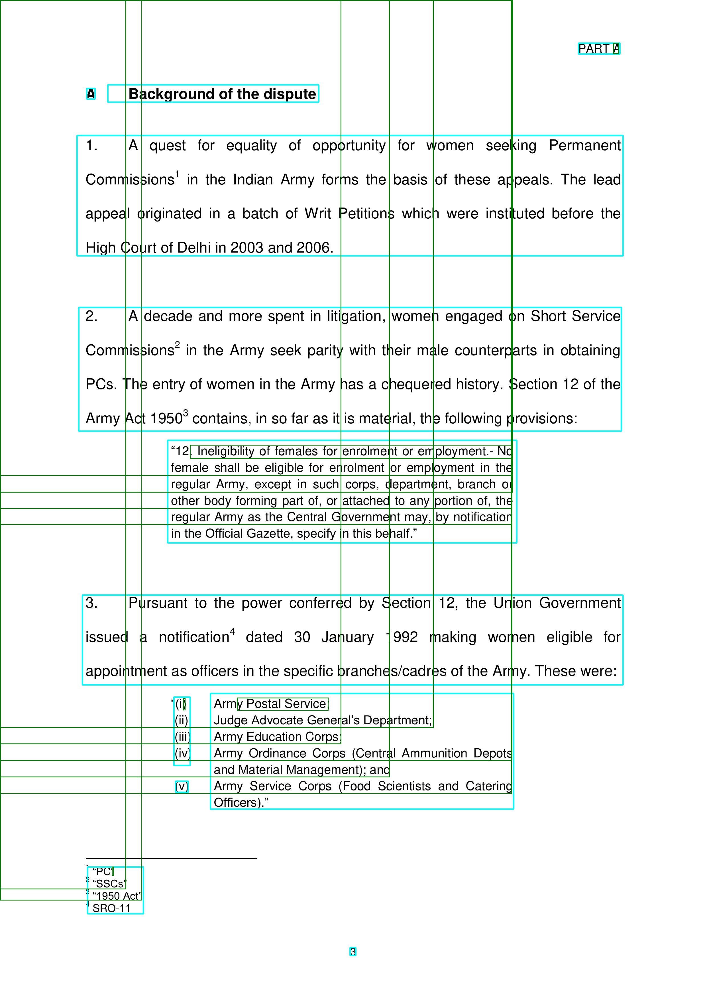

In [47]:
image